## Introduction
This notebook focuses on **3D registration** of the **left kidney** model using a structured computational pipeline. The goal is to **align a source Left kidney model** to a **reference (HRA) kidney model**, enabling accurate comparison and analysis.  


In [2]:
import sys
sys.path.append('/Users/antarabhavsar/Desktop/cnsKidney/hra-amap/src')

import trimesh

from organ import Organ
from tissue import TissueBlock
from pipeline import Pipeline
import open3d as o3d
import numpy as np
import matplotlib.pyplot as plt
from steps import normalize_rigid
from utils.conversions import to_array
from copy import deepcopy
import seaborn as sns
from sklearn.preprocessing import minmax_scale


left_kidney_path = "/Users/antarabhavsar/Desktop/cnsKidney/hra-amap/data/Kidney/Source/VH_M_Kidney_L.glb"
left_kidney_reference = "/Users/antarabhavsar/Desktop/cnsKidney/hra-amap/data/Kidney/Reference/VH_M_Kidney_L.glb"

### Loading the Source and Target Organ Models:  
In this step, we load the source organ (left kidney) and the target organ (reference left kidney) using the Organ class. 
The Organ class is used to handle and process 3D models of anatomical structures. The path parameter specifies the file locations of the left kidney source and left kidney reference models in GLB format, which will be used for further analysis and registration.

In [ ]:
source = Organ(path=left_kidney_path)
target = Organ(path=left_kidney_reference)

### Visualizing the Left Kidney Mesh Model

In this step, we use the `trimesh` library to load and visualize the **left kidney** model.  
The `trimesh.load_mesh()` function reads the 3D model from the specified path, and `mesh.show()` renders an interactive 3D view of the kidney structure.  

This helps in inspecting the **mesh geometry** before performing further processing such as **registration** or **analysis**.


In [5]:
import trimesh

mesh = trimesh.load_mesh(left_kidney_path)
mesh.show()

In [6]:
left_kidney = trimesh.load(left_kidney_path, force='mesh')
reddishpink = [0.4, 1.0, 1.0]

left_kidney.visual.vertex_colors = np.array([reddishpink] * len(left_kidney.vertices), dtype=np.uint8)

tissue_block = trimesh.creation.icosphere(subdivisions=3, radius=0.05)
tissue_block.visual.vertex_colors = np.array([0.8, 0.6, 0.2] * len(tissue_block.vertices), dtype=np.uint8)  # Mustard color

tissue_blocks_concatenated = trimesh.util.concatenate([tissue_block] * 10)

source_with_tbs = trimesh.Scene([left_kidney, tissue_blocks_concatenated])

source_with_tbs.show()

### Normalizing the Source and Target Point Clouds

In this step, we apply **rigid normalization** to align the **source** and **target** kidney models.  
The `normalize_rigid()` function ensures that both point clouds are scaled, rotated, and translated properly for better registration.  

- `deepcopy(source.pointcloud)` and `deepcopy(target.pointcloud)` create copies of the original point clouds to prevent modifications to the raw data.

In [7]:
output = normalize_rigid(source=deepcopy(source.pointcloud), target=deepcopy(target.pointcloud))

normalized_source_atlas = to_array(output.output['Source'])
normalized_target_atlas = to_array(output.output['Target'])


### Running the Registration Pipeline

In this step, initialize and execute the **registration pipeline** to align the **source kidney** model with the **target (HRA reference) kidney** model.  

- The `Pipeline` class is instantiated with a name, description, and configuration parameters (`params.yaml`), which define the registration settings.
- `pipeline.run(source, target)` processes the models and computes the transformation needed to align the source kidney with the target.
- `projections.registration.show()` visualizes the **registered organ**, allowing us to inspect the alignment quality.

This step ensures that the source kidney model is accurately mapped onto the reference kidney for further analysis.


In [8]:
pipeline = Pipeline(name='Forward Projections', description='Millitome Kidney to HRA Right Kidney', params='../configs/params.yaml')

In [9]:
projections = pipeline.run(source=source, target=target)

In [10]:
projections.registration.show()

In [11]:
output = normalize_rigid(source=deepcopy(source.pointcloud), target=deepcopy(target.pointcloud))

In [12]:
normalized_source_atlas = to_array(output.output['Source'])
normalized_target_atlas = to_array(output.output['Target'])

### Visualizing the Source and Target Point Clouds (Before Registration)

In this step, we create **point cloud visualizations** for the **source kidney** and **target (reference) kidney** models before registration.  

- `trimesh.PointCloud()` generates 3D point clouds from the **normalized source** and **target point clouds**.
- The **source kidney** is colored **red** (`[255, 0, 0, 255]`), while the **target kidney** is colored **blue** (`[0, 0, 255, 255]`) for easy differentiation.
- The `trimesh.Scene()` function combines both point clouds into a single 3D scene.
- `before_scene.show()` renders an **interactive visualization**, allowing us to inspect the initial alignment between the two models.

This visualization helps in understanding how much transformation is needed for accurate registration.


In [13]:
source_pc = trimesh.PointCloud(
    normalized_source_atlas, 
    colors=np.tile(np.array([255, 0, 0, 255]), (len(normalized_source_atlas), 1))
)
hra_pc = trimesh.PointCloud(
    normalized_target_atlas, 
    colors=np.tile(np.array([0, 0, 255, 255]), (len(normalized_target_atlas), 1))
)
before_scene = trimesh.Scene([source_pc, hra_pc])
before_scene.show()

In [14]:
trimesh.Scene([source_pc]).show()

In [15]:
trimesh.Scene([hra_pc]).show()

In [21]:
pipeline = Pipeline(name='Left Kidney Registration', description='Register Left Kidney Source to Reference', params='../configs/params.yaml')
projections = pipeline.run(source=source, target=target)

### Visualizing the Source and Target Point Clouds (After Registration)

This step visualizes the **aligned (registered) source kidney** and the **target (reference) kidney** models after the registration process.  

- The **projected source kidney** (after transformation) is represented as a **red point cloud** (`[255, 0, 0, 255]`).
- The **target kidney (HRA reference model)** remains **blue** (`[0, 0, 255, 255]`) for contrast.
- `trimesh.Scene()` combines both point clouds into a single 3D view.
- `after_scene.show()` renders an **interactive visualization**, allowing us to assess how well the **source kidney** has aligned with the **target kidney**.

This visualization helps evaluate the **effectiveness of the registration** and whether further refinement is needed.


In [17]:
projected_pc = trimesh.PointCloud(
    projections.registration.vertices, 
    colors=np.tile(np.array([255, 0, 0, 255]), (len(projections.registration.vertices), 1))
)
hra_pc = trimesh.PointCloud(
    target.vertices, 
    colors=np.tile(np.array([0, 0, 255, 255]), (len(target.vertices), 1))
)

after_scene = trimesh.Scene([projected_pc, hra_pc])

after_scene.show()



In [18]:
projections.registration.show()

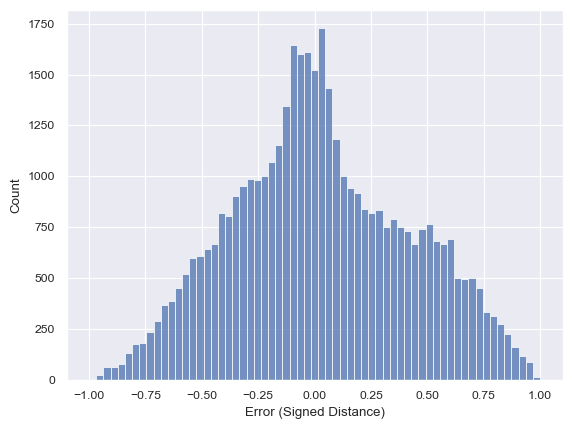

In [19]:
sd = trimesh.proximity.signed_distance(target, projections.registration.vertices)
sd_scaled = minmax_scale(sd, feature_range=(-1, 1), axis=0, copy=True)

sns.set_style('darkgrid')
sns.set_theme('paper')
hist = sns.histplot(data=sd_scaled).set_xlabel('Error (Signed Distance)')
fig = hist.get_figure()

### Heatmap Visualization of Registration Error

This step creates a **heatmap visualization** to analyze the **registration accuracy** by coloring the registered **source kidney** based on its deviation from the reference kidney.  

- The **signed distance values (`sd`)** between the registered source and target models are mapped to colors using the `'jet'` colormap.
- `trimesh.visual.interpolate()` applies the colormap to highlight **regions with high and low registration errors**.
- A new **Trimesh object** (`heatmap`) is created using:
  - **Vertices** from the **registered source kidney**.
  - **Faces** (triangular mesh elements) from the transformed model.
  - **Vertex colors** based on the error magnitude.
- `heatmap.show()` renders an interactive **3D visualization**, where:
  - **Blue areas indicate low registration error (good alignment).**
  - **Red/yellow areas indicate high error (misalignment).**

This visualization helps in diagnosing **misalignment issues** and understanding where improvements may be needed in the registration process.


In [20]:
cmap = 'jet'
colors = trimesh.visual.interpolate(sd, color_map=cmap)

heatmap = trimesh.Trimesh(
    vertices=np.array(projections.registration.vertices), 
    faces=np.array(projections.registration.faces), 
    vertex_colors=colors
)
heatmap.show()

## Conclusion

I performed **3D registration** of the **left kidney** model using a structured pipeline. The key steps included:  

1. **Loading and Normalizing the Data**  
   - The **source kidney** and **reference (HRA) kidney** models were loaded and preprocessed.  
   - Rigid normalization ensured the models were properly scaled and aligned for better registration accuracy.  

2. **Running the Registration Pipeline**  
   - The **pipeline-based registration** transformed the source model to closely match the reference model.  
   - The transformation was applied, and the registered model was generated.  

3. **Visualizing the Results**  
   - **Before registration:** A **red (source) and blue (target)** point cloud comparison was displayed.  
   - **After registration:** The transformed source kidney was overlaid on the reference kidney for alignment inspection.  
   - A **heatmap visualization** was created to highlight **registration errors**, where **blue areas indicated better alignment**, and **red/yellow areas showed discrepancies**.  

4. **Analyzing Registration Accuracy**  
   - A **histogram of registration errors** helped quantify the deviation between the models.  
   - The heatmap visualization provided an intuitive **error distribution** across the kidney surface.  

### Key Takeaways:
✅ The registration pipeline successfully **aligned** the source kidney with the reference kidney.  
✅ **Most areas** of the registered model showed good alignment (**low error regions in blue**).  
✅ Some **localized misalignments** were identified (**red/yellow regions in heatmap**), suggesting potential areas for refinement.  

### Future Improvements:
🔹 Fine-tuning the **registration parameters** to minimize alignment errors further.  
🔹 Exploring **non-rigid registration** to account for subtle shape differences in kidney structures.  
🔹 Integrating **additional validation metrics** to assess registration accuracy quantitatively.  

This workflow demonstrates a **robust approach for anatomical model registration**, aiding in accurate **3D analysis and visualization** in medical imaging and computational anatomy. 🚀  
